In [ ]:
import cv2
import os
from IPython.display import HTML
from base64 import b64encode
import locale

import shutil
import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Concatenate
from keras.layers import Input, Add, Conv2DTranspose
from keras.models import Sequential, Model
from keras.applications import VGG16
from keras.optimizers import SGD, Adam
from keras.losses import SparseCategoricalCrossentropy, MeanSquaredError, BinaryCrossentropy
from keras.utils import plot_model
from keras.callbacks import Callback
from keras import callbacks
import matplotlib.pyplot as plt

import datetime

# useful for copying data from server to gdrive
locale.getpreferredencoding = lambda: "UTF-8"

# **Initializing the constants**

In [ ]:
imgHeight = 224
imgWidth = 224
'''
  We are using img size of (224, 224) because VGG16 was trained on img dataset of size (224, 224).
  VGG16 also can accept img sizes from a min of (32, 32).
  If we want to train VGG16 with custom image sizes (Typically the o/p of your cam feed) then you may have to adjust some parameters such as the padding, stride, and kernel size of the convolutional layers.
  Also you may have to specify the pooling method before the fully connected layers to handle inputs of any size 45.
'''
numberOfChannels = 3 # number of channels
numberOfClasses = 1  # Number of classes to segment. (since, we are focusing on road N_CLASSES = 1)

# **Mounting the Data folder into Server.**

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:

from google.colab.patches import cv2_imshow

# **Sample code for processing 1 image.**

<class 'tensorflow.python.framework.ops.EagerTensor'>
tf.Tensor(b'/content/gdrive/My Drive/Colab Notebooks/FCN/data/KITTI-Road-Segmentation/training/gt_image_2/um_road_000000.png', shape=(), dtype=string)
(375, 1242, 3)
(375, 1242)
(375, 1242)
(375, 1242, 1)


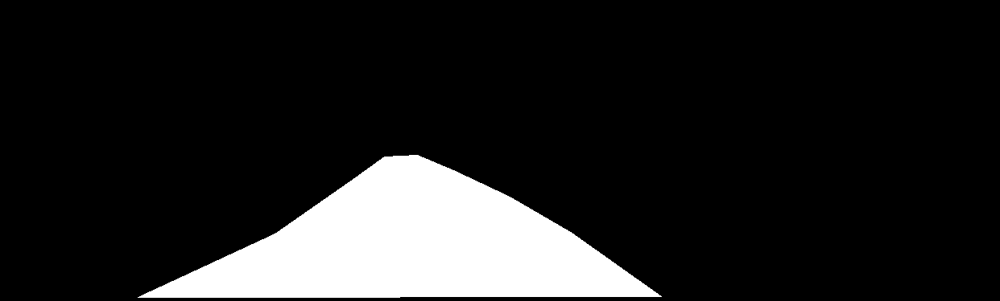

(375, 1242, 1)


In [ ]:
# !ls '/content/gdrive/My Drive/Colab Notebooks/FCN/data/KITTI-Road-Segmentation/training/image_2'

img_path = '/content/gdrive/My Drive/Colab Notebooks/FCN/data/KITTI-Road-Segmentation/training/image_2/um_000000.png'
image = tf.io.read_file(img_path) # reads the contents of the file specified by img_path and returns it as a tensor (PNG encoded image)
print(type(image))
image = tf.image.decode_png(image, channels=3)  # it returns a tensor array of RGB img (decodes PNG encoded img to tensor array)
image = image.numpy()   # converting tensor array to unmpy array (RGB)

mask_path = tf.strings.regex_replace(img_path, "image_2", "gt_image_2") # it replaces 'image_2' in img_path with 'gt_image_2'. if 'image_2' is not in img_path then it will return img_path without replacing anything.
mask_path = tf.strings.regex_replace(mask_path, "um_", "um_road_")
mask_path = tf.strings.regex_replace(mask_path, "umm_", "umm_road_")
mask_path = tf.strings.regex_replace(mask_path, "uu_", "uu_road_")

print(mask_path)
# Segmented Mask in KITTI Road Dataset is 3 chaneel img of 3 segmented colors. road as magenta, non-road areas as red, and more road surfaces in black.

mask = tf.io.read_file(mask_path)
mask = tf.image.decode_png(mask, channels=3)
#mask = mask.numpy()

non_road_label = np.array([255, 0, 0]) # non-road areas as red
road_label = np.array([255, 0, 255])  # road as magenta
other_road_label = np.array([0, 0, 0]) # more road surfaces in black
print(mask.shape)
# Creating a Binary Road mask from 3 channeled segmented mask.
# First we check each pixel value of mask == road_label array in depth-channel wise (axis of index 2). so that we can sort out all the magenta color in mask.
mask = tf.experimental.numpy.all(mask == road_label, axis = 2)  # you can also use np (np.all(mask == road_label, axis = 0)) instead of tf. tensorflow-numpy is faster than numpy. so iam using tf numpy
# above line return array of dim(375, 1242) with values of True if the pixel has value of road_label. i.e [255, 0, 255]. else False.
print(mask.shape)
mask = tf.cast(mask, tf.uint8)   # this will change the dtype. False --> 0 and True --> 1
print(mask.shape)
mask = tf.expand_dims(mask, axis=-1)  # this will add 1 dimention as extra end axis. i.e of shape (375, 1242, 1) --> GrayScale Img
print(mask.shape)




#mask = cv2.cvtColor(mask, cv2.COLOR_RGB2BGR)

# to visualize image
''' image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
cv2_imshow(image)
print(image.shape) '''
# to visualize mask
mask = mask.numpy()
mask = mask*255
cv2_imshow(mask)
print(mask.shape)

<div class="markdown-google-sans">
  
# **KITTI Dataset Format and it's Folder Structure.**
</div>


## **KITTI-Road-Segmentation**
> ### **testing**
>> #### **testing_videos.mp4**

> ### **training**
>> #### **image_2**
>>> Total = 289 images of .png format.And img names start with 'um_' or 'umm_' or 'uu_'

>> #### **gt_image_2**
>>> * semantic_segmentation_masks of above 289 images with .png format.
* semantic_segmentation_mask names start with 'um_road_' or 'umm_road_' or 'uu_road_'.
* Segmented Mask in KITTI Road Dataset is 3 chaneel img of 3 segmented colors.

>>> road as magenta,

>>> non-road areas as red,

>>> more road surfaces in black.





<div class="markdown-google-sans">
  
# **Pre-processing Data, Helper Functions**
</div>

<div class="markdown-google-sans">
  
## **<h2>Helper Functions</h2>**
</div>



1. image_mapping(img_path)
> It takes **image_path** as input and returns a **dictionary** of *image and it's binary road_segmentation_mask* with only 1 channel i.e gray binary mask (non-road and more-road segmentations are ignored).
2. normalize(input_image: tf.Tensor, input_mask: tf.Tensor)
> It takes image, mask as input and returns a **tuple** of *image, mask having pixel values between 0 and 1*
3. loadTrainingData(datapoint: dict)
> It takes **Dictionary** (o/p of image_mapping function.) as i/p and returns a **tuple** *of image, mask after resizing, flipping, normalizing* those.
4. loadTestingData(datapoint: dict)
> It takes **Dictionary** (o/p of image_mapping function.) as i/p and returns a **tuple** *of image, mask after resizing, normalizing* those
5. visualizeData(display_list)
> It takes a **list of images** (input image, Truth Mask, predicted mask) as i/p and *display's those images in 1 column.*






In [ ]:
# below function takes image_path as input and returns a dict of image and it's binary road_segmentation_mask with only 1 channel i.e gray binary mask (non-road and more-road segmentations are ignored).

@tf.function
def image_mapping(img_path):
  image = tf.io.read_file(img_path) # reads the contents of the file specified by img_path and returns it as a tensor (PNG encoded image)
  #print(type(image))
  image = tf.image.decode_png(image, channels=3)  # it returns a tensor array of RGB img (decodes PNG encoded img to tensor array)

  mask_path = tf.strings.regex_replace(img_path, "image_2", "gt_image_2") # it replaces 'image_2' in img_path with 'gt_image_2'. if 'image_2' is not in img_path then it will return img_path without replacing anything.
  mask_path = tf.strings.regex_replace(mask_path, "um_", "um_road_")
  mask_path = tf.strings.regex_replace(mask_path, "umm_", "umm_road_")
  mask_path = tf.strings.regex_replace(mask_path, "uu_", "uu_road_")

  mask = tf.io.read_file(mask_path)  # reading mask in mask_path as encoded img.
  mask = tf.image.decode_png(mask, channels=3)  # converting above encoded img to RGB img.

  # Define the pixel intensities for the colors in mask.
  non_road_label = np.array([255, 0, 0]) # non-road areas as red
  road_label = np.array([255, 0, 255])  # road as magenta
  other_road_label = np.array([0, 0, 0]) # more road surfaces in black

  # Creating a Binary Road mask from 3 channeled segmented mask.
  # First we check each pixel value of mask == road_label array in depth-channel wise (axis of index 2). so that we can sort out all the magenta color in mask.
  mask = tf.experimental.numpy.all(mask == road_label, axis = 2)  # you can also use np (np.all(mask == road_label, axis = 0)) instead of tf. tensorflow-numpy is faster than numpy. so iam using tf numpy
  # above line return array of dim(375, 1242) with values of True if the pixel has value of road_label. i.e [255, 0, 255]. else False. But this returned mask will have 3 channels compressed in to 1 channel.

  mask = tf.cast(mask, tf.uint8)   # this will change the dtype. False --> 0 and True --> 1. But it is also a 3channeled mask compressed into 1 channel.

  mask = tf.expand_dims(mask, axis=-1)  # this will add 1 dimention as extra end axis. i.e of shape (375, 1242, 1) --> GrayScale Img. This will ensure that the mask is Gray scale.

  # to visualize image. Takeout the code inside this function and paste it in separate cell and run it on 1 image. and uncomment the below code.
  ''' image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  cv2_imshow(image)
  print(image.shape)
  # to visualize mask
  mask = mask.numpy()
  mask = mask*255
  cv2_imshow(mask)
  print(mask.shape) '''

  img_dict = {'image': image, 'segmentation_mask': mask}
  return img_dict

In [ ]:
'''
@tf.function decorator
  not all Python functions need to be decorated with @tf.function.
  In general, it is recommended to use @tf.function for functions that are computationally expensive and are called repeatedly
'''

# PRE-PROCESSING DATA.
'''
  1. Normalize : we dividie each pixel value by 255. this step converts int values to float.
                 normalization is done to ensure that the input features are on a similar scale, which can make it easier for the network to learn the weights and biases.
  2. loadTrainingData : this takes img_dict as input. Resize the img to a standart (224, 224, 3) shape.
                        Randomly flips the img, mask to increase diversity in training data (this improves the model quality).
                        normalizes the img, mask using above normalize funtion and returns the tuple of normalized img and it's mask.
  3. loadTestingData : this takes img_dict as input. Resize the img to a standart (224, 224, 3) shape.
                        normalizes the img, mask using above normalize funtion and returns the tuple of normalized img and it's mask.
'''
@tf.function
def normalize(input_image: tf.Tensor, input_mask: tf.Tensor):  # we are passing input_mask along with input_image eventhough we are not using input_mask. that is done just to keep/track them together
  input_image = tf.cast(input_image, tf.float32)/255.0   # first we are converting the int values to float32 and then dividing the pixel values by float 255.0
  return (input_image, input_mask)

@tf.function
def loadTrainingData(datapoint: dict):
  # Resizing the img, mask to a standard (224, 224, 3) shape. Because VGG16 is trained on DataSet of this shape. So we don't need to alter padding, stride, kernels.
  input_image = tf.image.resize(datapoint['image'], (imgHeight, imgWidth))
  input_mask = tf.image.resize(datapoint['segmentation_mask'], (imgHeight, imgWidth))

  # This if loop is used to randomly flip the input image and mask. This can help improve the performance of the network by increasing the diversity of the training data.
  # You can also train the model commenting below if block.
  if tf.random.uniform(shape=(), minval=0, maxval=1) > 0.5:  # tf.random.uniform(shape=(), minval=0, maxval=1) produces a random scalar value b/w 0 and 1.
      input_image = tf.image.flip_left_right(input_image)
      input_mask = tf.image.flip_left_right(input_mask)

  input_image, input_mask = normalize(input_image, input_mask)

  return (input_image, input_mask)

@tf.function
def loadTestingData(datapoint: dict):
  # Resizing the img, mask to a standard (224, 224, 3) shape. Because VGG16 is trained on DataSet of this shape. So we don't need to alter padding, stride, kernels.
  input_image = tf.image.resize(datapoint['image'], (imgHeight, imgWidth))
  input_mask = tf.image.resize(datapoint['segmentation_mask'], (imgHeight, imgWidth))

  input_image, input_mask = normalize(input_image, input_mask)

  return (input_image, input_mask)

In [ ]:
# To visualize the data (input image, True mask, Predicted mask)

def visualizeData(display_list):
  plt.figure(figsize=(10, 10))  # this will ensure that the every image that we are going to plot is os 5x5 inches.

  titles = ['Input Image', 'True Mask', 'Predicted Mask']

  for i in range(len(display_list)):
    #print(type(display_list[i]))
    plt.subplot(1, len(display_list), i+1)  # display all images in 1 cloumn, len(list) rows.
    plt.title(titles[i])
    plt.imshow(display_list[i])

  plt.show()


<div class="markdown-google-sans">
  
## **<h2>Preparing Data for Training, Validation and Testing</h2>**
</div>


*   Make a list of all the image_path's with **.png** extention. And apply .map() on it, which takes function (image_mapping) as param.
Result is **dataset** containing dictionaries. each dict has image and corresponding road_mask.

*   Define the sizes for training (80%), validation(10%) and testing datasets
*   Splitting the above dataset into training, validation and testing samples of defined sizes.
*   Splitting the training data into batches. Each batch size is 32.


>> Training data
*   First we apply loadTrainingData() function on train dataset containing dictionaries. It will return a dataset containing a tuple of image and corresponding mask.
*   Apply .shuffle() on above train dataset. it results in shuffled train dataset.
*   apply .repeat() function. which results in a train dataset of infinite length.
*   apply .batch() to split the train dataset into batches. each batch is of 32 tuples.
*   apply .prefetch() on above train dataset. it helps in prefetching the data. it optimmizes the time.

>> Validation Data
*   First we apply loadTrainingData() function on validation dataset containing dictionaries. It will return a dataset containing a tuple of image and corresponding mask.
*   apply .repeat() function. which results in a validation dataset of infinite length.
*   apply .batch() to split the validation dataset into batches. each batch is of 32 tuples.
*   apply .prefetch() on above validation dataset. it helps in prefetching the data. it optimmizes the time.

>> Testing Data
*   First we apply loadTestingData() function on testing dataset containing dictionaries. It will return a dataset containing a tuple of image and corresponding mask.
*   apply .batch() to split the testing dataset into batches. each batch is of 32 tuples.
*   apply .prefetch() on above testing dataset. it helps in prefetching the data. it optimmizes the time.







In [ ]:
# !ls '/content/gdrive/My Drive/Colab Notebooks/FCN/data/KITTI-Road-Segmentation/training/image_2'
train_data_dir = '/content/gdrive/My Drive/Colab Notebooks/FCN/data/KITTI-Road-Segmentation/training/image_2/'
dataset = tf.data.Dataset.list_files(train_data_dir + "*.png", seed = 123)  # without 'seed' param. we will get the imgpath|s in random order(everytime we run the code, order changes.). seed=123 keeps shuffled-order constant for every run.
print(dataset)
print(len(dataset))
print(type(dataset))
# To view the contents of dataset. To access contents of dataset, we have to use .take() function.
''' for element in dataset.take(10):
    print(element) '''

dataset = dataset.map(image_mapping)  # this will iterate through all the img_path's in dataset and apply the image_mapping on every img_path and store the return values in dataset variable.
# To view the contents of dataset. To access contents of dataset, we have to use .take() function.
''' for element in dataset.take(1): # element is a dictionary returned by image_mapping function
    print(element['image'])
    print(element['segmentation_mask']) '''


<_ShuffleDataset element_spec=TensorSpec(shape=(), dtype=tf.string, name=None)>
289
<class 'tensorflow.python.data.ops.shuffle_op._ShuffleDataset'>


" for element in dataset.take(1): # element is a dictionary returned by image_mapping function\n    print(element['image'])\n    print(element['segmentation_mask']) "

In [ ]:
# Defining sizes of train, validation, test datasets.
trainDataSetSize = int(len(os.listdir(train_data_dir)) * 0.8)

validationDataSetSize = int(len(os.listdir(train_data_dir)) * 0.1)

testDataSetSize = int(len(os.listdir(train_data_dir)) - trainDataSetSize - validationDataSetSize)

print('train_size : {} \ntest_size : {} \nvalidation_size : {}'.format(trainDataSetSize, testDataSetSize, validationDataSetSize))

train_size : 231 
test_size : 30 
validation_size : 28


In [ ]:
# Splitting the above dataset into training, validation and testing samples of defined sizes.

testDataSet = dataset.take(testDataSetSize) # this will take first testDataSetSize elements in dataset
train_validation_dataSet = dataset.skip(testDataSetSize) # this will skip first testDataSetSize elements in dataset but taked the rest.
trainDataSet = train_validation_dataSet.take(trainDataSetSize) # this will take first trainDataSetSize elements in train_validation_dataSet
validationDataSet = train_validation_dataSet.skip(trainDataSetSize) # this will skip first trainDataSetSize elements in train_validation_dataSet but taked the rest.

print('testDataSet_size : {} \ntrainDataSet_size : {} \nvalidationDataSet_size : {}'.format(len(testDataSet), len(trainDataSet), len(validationDataSet)))

testDataSet_size : 30 
trainDataSet_size : 231 
validationDataSet_size : 28


In [ ]:
# Splitting the training data into batches.
batch_size = 16
buffer_size = 50

allDataSets = {'train': trainDataSet, 'val': validationDataSet, 'test' : testDataSet}

# training Data set

# num_parallel_calls=tf.data.AUTOTUNE param will enable parallel processings based on your CPU capacity. if it is not specified, then processing happens 1 dict after the other
allDataSets['train'] = allDataSets['train'].map(loadTrainingData, num_parallel_calls=tf.data.AUTOTUNE)   # for every dict in trainDataSet, we are applying loadTrainingData function.
# Now trainDataSet is a tf.Tensor of tuples. each tuple contains img, mask after pre-processing.
allDataSets['train'] = allDataSets['train'].shuffle(buffer_size = buffer_size, seed = 123) # shuffles the data in better way compared to normal shuffle.
allDataSets['train'] = allDataSets['train'].repeat() # this will allow the dataset to repeat infinite times. So, length is unlinited but the execution will not get into infinite loop. Tensorflow Optimizer handles it in training process.
allDataSets['train'] = allDataSets['train'].batch(batch_size) # this will divide the dataset in to subdatasets of 32 elements each. And the last batch might contain < 32 elements.
allDataSets['train'] = allDataSets['train'].prefetch(buffer_size=tf.data.AUTOTUNE) # used to prefetch elements from a dataset ahead of the time they are requested. This can help improve training performance by overlapping the preprocessing of one batch with the training of another batch.


# validation Data set
allDataSets['val'] = allDataSets['val'].map(loadTrainingData)
allDataSets['val'] = allDataSets['val'].repeat()
allDataSets['val'] = allDataSets['val'].batch(batch_size)
allDataSets['val'] = allDataSets['val'].prefetch(buffer_size=tf.data.AUTOTUNE)

# testing data set

# We don't need to test the model with lot's of data. So we are not using repeat()
allDataSets['test'] = allDataSets['test'].map(loadTestingData)
allDataSets['test'] = allDataSets['test'].batch(batch_size)
allDataSets['test'] = allDataSets['test'].prefetch(buffer_size=tf.data.AUTOTUNE)


# above datasets will have data in batches. each batch has 32 elements. but number of batches is None because we used .repeat().
''' for batch in allDataSets['train'].take(1):
    print(batch) '''
# each batch has shape of shape=(32, 224, 224, 3) for img and shape=(32, 224, 224, 1) for road-mask.




" for batch in allDataSets['train'].take(1):\n    print(batch) "

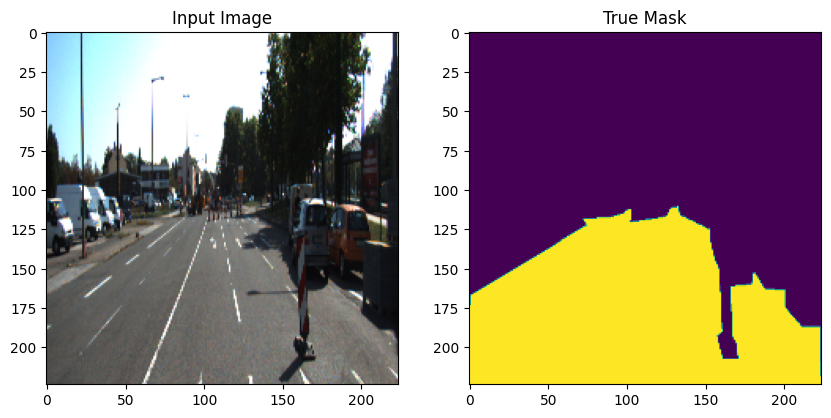

In [ ]:
# below code is just to visualize the functionality of visualizeData() function that we defined earlier.
for image, mask in allDataSets["test"].take(1):   # image, mask = a batch of (images, maskes)
    sample_image, sample_mask = image, mask   # sample_image = a list of 32 images   , samples_mask = list of 32 corresponding masks

visualizeData([sample_image[0], sample_mask[0]])

<div class="markdown-google-sans">

# **Creating new FCN8 model using VGG16 as Encoder**
</div>



<div class="markdown-google-sans">
  
**<h2>FCN8 Architecture</h2>**
</div>

FCN has 2 parts = Encoder + Decoder

Encoder:
*  We are using VGG16 as Encoder. And We will extract the outputs of Block3, 4, 5 for future use in Decoder part.

Decoder Part:
* Upsample the output of Block 5 by a factor of 2 and add/concatenate it to Block 4 output.

* Upsample the above result by a factor of 2 and add/concatenate it to Block 3 output.

* Upsample the above result by a factor of 8.


****************************************************

FCN8 Decoder has  3 upsamplings (2, 2, 8).

FCN16 Decoder has  2 upsamplings (2, 16).

FCN32 Decoder has  1 upsamplings (32).


<div class="markdown-google-sans">
  
**<h2>VGG16 Architecture</h2>**
</div>

VGG16 = 16 Layers = 5 pooling layers + 11 convolutional layers
VGG16 has 5 blocks.

* Block 1 has 2 Convolutional Layers and 1 pooling layer
* Block 2 has 2 Convolutional Layers and 1 pooling layer
* Block 3 has 3 Convolutional Layers and 1 pooling layer
* Block 4 has 3 Convolutional Layers and 1 pooling layer
* Block 5 has 3 Convolutional Layers and 1 pooling layer

For explanation visit [here](https://www.youtube.com/watch?v=bEsRLXY7GCo)

In [ ]:
input_shape = (imgHeight, imgWidth, numberOfChannels)
inputs = Input(input_shape)  # converting tuple to keras Input object

In [ ]:
#VGG network  = Encoder part + Decoder Part

# Encoder Layers
#vgg16_model = VGG16(include_top=False, weights='imagenet', input_tensor=inputs)  # we are using VGG16 as encoder for our FCN
#/content/gdrive/MyDrive/Colab Notebooks/FCN/best_model_after_epoch35.h5
vgg16_model = VGG16(include_top=False, weights='imagenet', input_tensor=inputs)
# We are extracting output of block3, 4, 5 of VGG16
c1 = vgg16_model.get_layer('block3_pool').output
c2 = vgg16_model.get_layer('block4_pool').output
c3 = vgg16_model.get_layer('block5_pool').output

# Decoder
# Upsampling (using Interpolation technique) the block5 output (2x) and concatinating the result to block4 output
u1 = UpSampling2D((2,2), interpolation='bilinear')(c3)
d1 = Concatenate()([u1, c2])

# Upsampling the
u2 = UpSampling2D((2,2), interpolation='bilinear')(d1)
d2 = Concatenate()([u2, c1])

# Output
u3 = UpSampling2D((8, 8), interpolation='bilinear')(d2)
outputs = Conv2D(numberOfClasses, 1, activation='sigmoid')(u3)   # this line ensures that the final output is single channel img containing 0's and 1's (1 for road, 0 else where)

# Final FCN8 model
model = Model(inputs, outputs, name = 'VGG16_FCN8')


58889256/58889256 [==============================] - 1s 0us/step


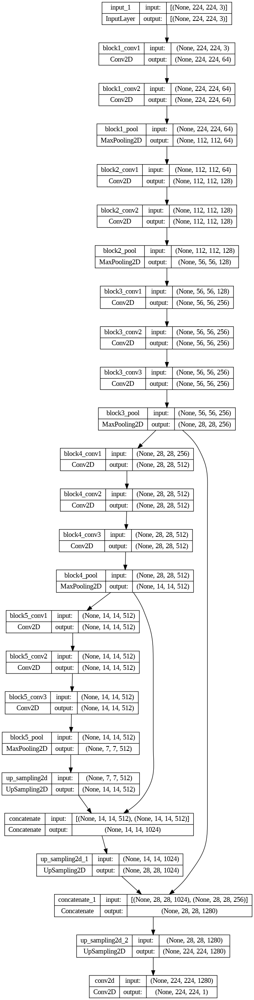

In [ ]:
plot_model(model, "FCN8_model_structure.png",show_shapes=True)  # to visualize the FCN8 model

In [ ]:
# To move the image from server to Google Drive folder.

!scp -r 'FCN8_model_structure.png' '/content/gdrive/My Drive/Colab Notebooks/FCN'

<div class="markdown-google-sans">
  
# **Training the FCN8**
</div>

<div class="markdown-google-sans">
  
## **Compiling the FCN8 model**
</div>

In [ ]:
# code for continuing the training after 35 epochs using bestweights file saved after 35 epochs.

model.load_weights('/content/gdrive/MyDrive/Colab Notebooks/FCN/best_model_train2_epoch30.h5')

In [ ]:
# model.compile() is used to configure the model for training. It specifies the optimizer, loss function, and metrics to be used during training.
model.compile(optimizer=Adam(), loss=BinaryCrossentropy(), metrics=[tf.keras.metrics.MeanIoU(num_classes=numberOfClasses + 1)])

'''
Some available loss functions
For image classification :
  loss = SparseCategoricalCrossentropy
For image Segmentation :
  loss = BinaryCrossentropy()
  loss = CategoricalCrossentropy()
  we can also use Focal Loss, Jaccard loss, Dice loss functions
'''
'''
Metrics can be : Keras provides many other built-in metrics that can be used for different types of problems, such as regression, classification, and segmentation
  Accuracy: The proportion of correct predictions to total predictions.
  Precision: The proportion of true positives to true positives plus false positives.
  Recall: The proportion of true positives to true positives plus false negatives.
  F1 score: The harmonic mean of precision and recall.
  AUC: The area under the receiver operating characteristic (ROC) curve.

  For Image Segmentation :
      metrics=[tf.keras.metrics.MeanIoU(num_classes=2)])

      where MeanIoU is a common evaluation metric for semantic image segmentation. It computes the intersection-over-union for each class and then returns the mean of these values. The formula for IoU is: IoU = true_positives / (true_positives + false_positives + false_negatives)

      Since, we are trying to segment the road (i.e 1 class). We need to pass MeanIoU(2).
      if we are segmenting 'n' classes, then we should use MeanIoU(n+1).
'''

"\nMetrics can be : Keras provides many other built-in metrics that can be used for different types of problems, such as regression, classification, and segmentation\n  Accuracy: The proportion of correct predictions to total predictions.\n  Precision: The proportion of true positives to true positives plus false positives.\n  Recall: The proportion of true positives to true positives plus false negatives.\n  F1 score: The harmonic mean of precision and recall.\n  AUC: The area under the receiver operating characteristic (ROC) curve.\n\n  For Image Segmentation :\n      metrics=[tf.keras.metrics.MeanIoU(num_classes=2)])\n\n      where MeanIoU is a common evaluation metric for semantic image segmentation. It computes the intersection-over-union for each class and then returns the mean of these values. The formula for IoU is: IoU = true_positives / (true_positives + false_positives + false_negatives)\n\n      Since, we are trying to segment the road (i.e 1 class). We need to pass MeanIoU

1/1 [==============================] - 16s 16s/step


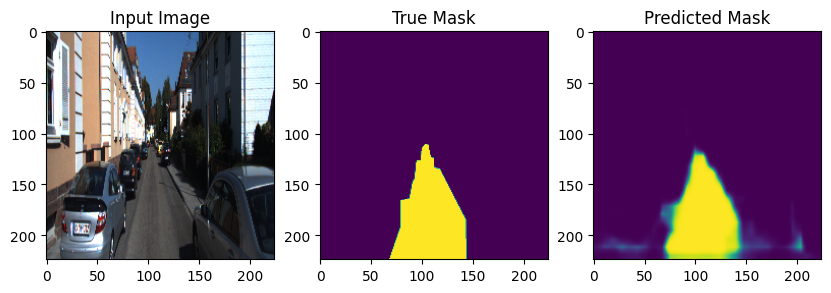

In [ ]:
# Function to create a mask out of network prediction
def create_mask(pred_mask: tf.Tensor) -> tf.Tensor:
    # Round to closest
    pred_mask = tf.math.round(pred_mask)

    # [IMG_SIZE, IMG_SIZE] -> [IMG_SIZE, IMG_SIZE, 1]
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask

# Function to show predictions
def show_predictions(dataset=None, num=1):
    if dataset:
        # Predict and show image from input dataset
        for image, true_mask in dataset.take(num):
            pred_mask = model.predict(image)
            visualizeData([image[0], true_mask, create_mask(pred_mask)])
    else:
        # Predict and show the sample image
        inference = model.predict(sample_image)
        visualizeData([sample_image[0], sample_mask[0],
                        inference[0]])

for image, mask in allDataSets['train'].take(1):
    sample_image, sample_mask = image, mask

show_predictions()

In [ ]:
# pre-steps to TRAIN the Model

class DisplayCallback(Callback):
    def on_epoch_end(self, epoch, logs=None):
        show_predictions()
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

        if epoch in [1, 3, 6, 9, 12, 15, 18, 21, 25, 28]:   # epoch 0 is ignored
          # To move the image from server to Google Drive folder.
          os.makedirs('/content/gdrive/My Drive/Colab Notebooks/FCN/best_model_train3', exist_ok=True)

          dest_path = '/content/gdrive/My Drive/Colab Notebooks/FCN/best_model_train3/best_model_train3_epoch{}.h5'.format(epoch+1)
          dest_path = repr(dest_path)
          !scp -r '/content/best_model.h5' $dest_path

logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

callbacks = [
    DisplayCallback(),
    callbacks.TensorBoard(logdir, histogram_freq = -1),
    callbacks.EarlyStopping(patience = 10, verbose = 1),
    callbacks.ModelCheckpoint('best_model.h5', verbose = 1, save_best_only = True)
]

'''
  Those callbacks execute at the end of every epoch during model training.
  DisplayCallback()  : if display the original image, truth_mask and predicted mask. and also print the statement mentioned in object method.
  callbacks.TensorBoard(logdir, histogram_freq = -1  --> it write the logs. and since histogram_freq = -1, it will disable the histogram computation.
                                                          i.e histograms will not be included in TensorBoard logs.
  callbacks.EarlyStopping(patience = 10, verbose = 1)   --> It stops the model training process if there is no improvement in loss value at the end of 10 epoch.
                                                            The verbose parameter controls the amount of information displayed during training.
                                                            A value of 1 indicates that progress messages will be displayed when the callback takes an action.
   callbacks.ModelCheckpoint('best_model.h5', verbose = 1, save_best_only = True) -->  this callback is to save the model weights at some frequency during training.
                                                                                      best model weights are saved in file best_model.h5
                                                                                      verbose do the same job as it does in above callback.
                                                                                      save_best_only --> if True, it only saves best model.
                                                                                                          if False, it saves the model at end of every epoch.
'''

# Set Variables
EPOCHS = 30
STEPS_PER_EPOCH = trainDataSetSize // batch_size
VALIDATION_STEPS = validationDataSetSize // batch_size

Epoch 1/30
1/1 [==============================] - 13s 13s/step


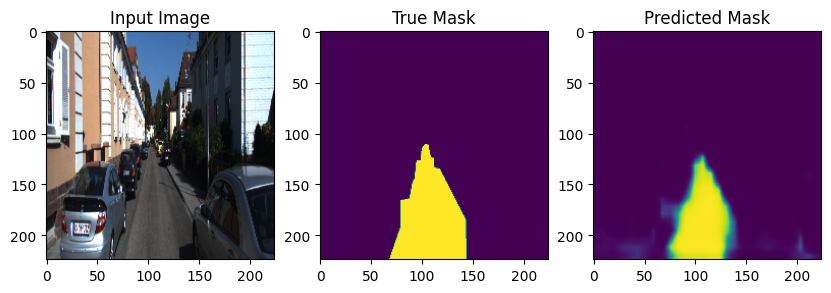


Sample Prediction after epoch 1


Epoch 1: val_loss improved from inf to 0.06706, saving model to best_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


14/14 [==============================] - 744s 52s/step - loss: 0.0950 - mean_io_u: 0.4134 - val_loss: 0.0671 - val_mean_io_u: 0.4088
Epoch 2/30
1/1 [==============================] - 13s 13s/step


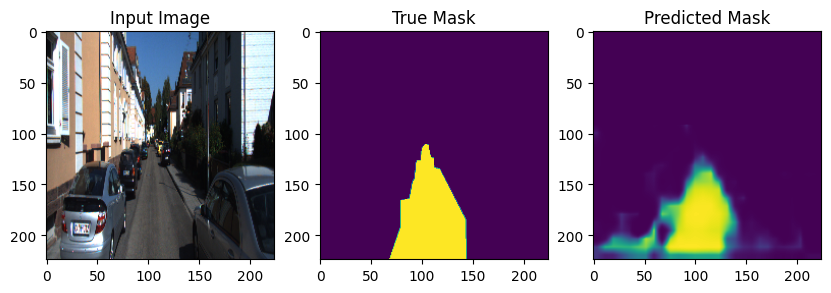


Sample Prediction after epoch 2


Epoch 2: val_loss improved from 0.06706 to 0.04904, saving model to best_model.h5
14/14 [==============================] - 667s 48s/step - loss: 0.0660 - mean_io_u: 0.4119 - val_loss: 0.0490 - val_mean_io_u: 0.4084
Epoch 3/30
1/1 [==============================] - 13s 13s/step


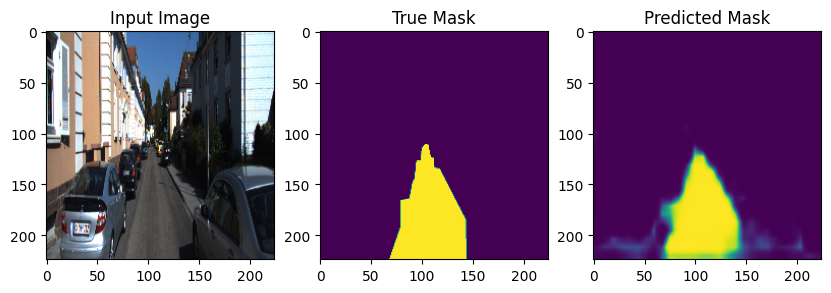


Sample Prediction after epoch 3


Epoch 3: val_loss improved from 0.04904 to 0.04333, saving model to best_model.h5
14/14 [==============================] - 655s 47s/step - loss: 0.0536 - mean_io_u: 0.4119 - val_loss: 0.0433 - val_mean_io_u: 0.4148
Epoch 4/30
1/1 [==============================] - 12s 12s/step


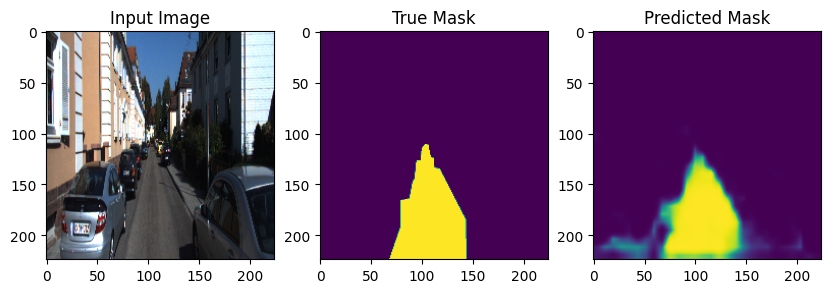


Sample Prediction after epoch 4


Epoch 4: val_loss improved from 0.04333 to 0.04022, saving model to best_model.h5
14/14 [==============================] - 657s 47s/step - loss: 0.0444 - mean_io_u: 0.4120 - val_loss: 0.0402 - val_mean_io_u: 0.4120
Epoch 5/30
1/1 [==============================] - 12s 12s/step


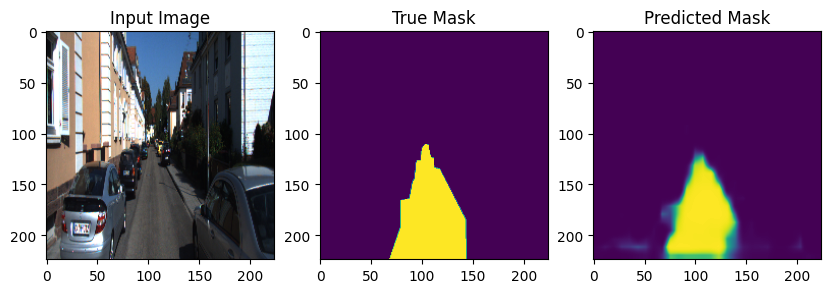


Sample Prediction after epoch 5


Epoch 5: val_loss did not improve from 0.04022
14/14 [==============================] - 667s 48s/step - loss: 0.0407 - mean_io_u: 0.4131 - val_loss: 0.0457 - val_mean_io_u: 0.4022
Epoch 6/30
1/1 [==============================] - 13s 13s/step


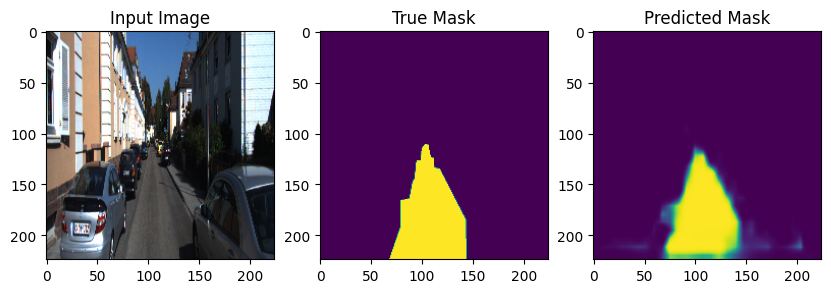


Sample Prediction after epoch 6


Epoch 6: val_loss improved from 0.04022 to 0.03808, saving model to best_model.h5
14/14 [==============================] - 659s 47s/step - loss: 0.0405 - mean_io_u: 0.4137 - val_loss: 0.0381 - val_mean_io_u: 0.4127
Epoch 7/30
1/1 [==============================] - 13s 13s/step


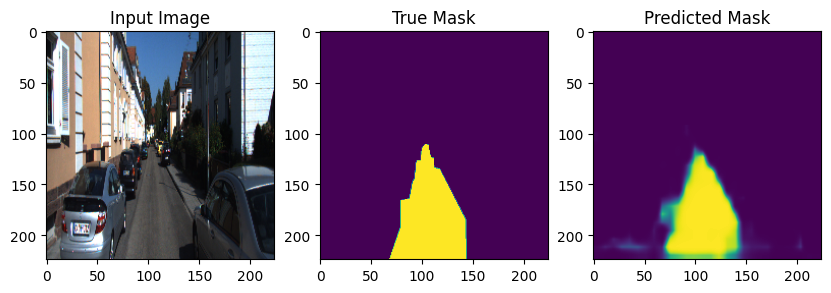


Sample Prediction after epoch 7


Epoch 7: val_loss did not improve from 0.03808
14/14 [==============================] - 660s 47s/step - loss: 0.0385 - mean_io_u: 0.4123 - val_loss: 0.0394 - val_mean_io_u: 0.4088
Epoch 8/30
1/1 [==============================] - 13s 13s/step


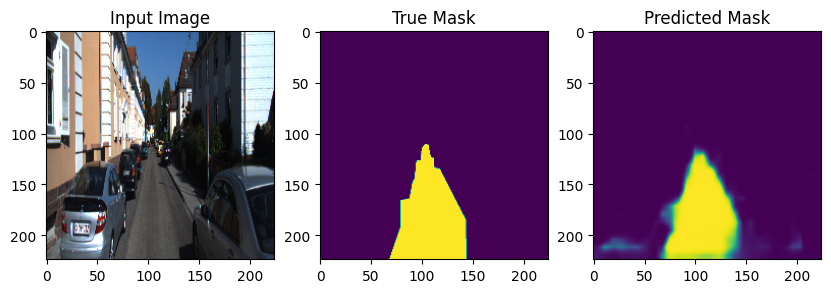


Sample Prediction after epoch 8


Epoch 8: val_loss did not improve from 0.03808
14/14 [==============================] - 667s 48s/step - loss: 0.0426 - mean_io_u: 0.4123 - val_loss: 0.0387 - val_mean_io_u: 0.4253
Epoch 9/30
1/1 [==============================] - 13s 13s/step


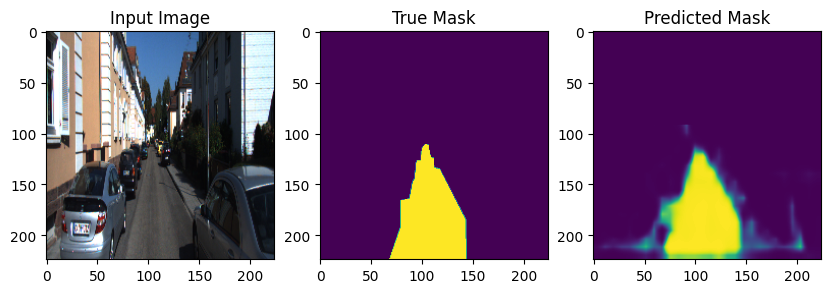


Sample Prediction after epoch 9


Epoch 9: val_loss did not improve from 0.03808
14/14 [==============================] - 664s 48s/step - loss: 0.0421 - mean_io_u: 0.4145 - val_loss: 0.0452 - val_mean_io_u: 0.4093
Epoch 10/30
1/1 [==============================] - 13s 13s/step


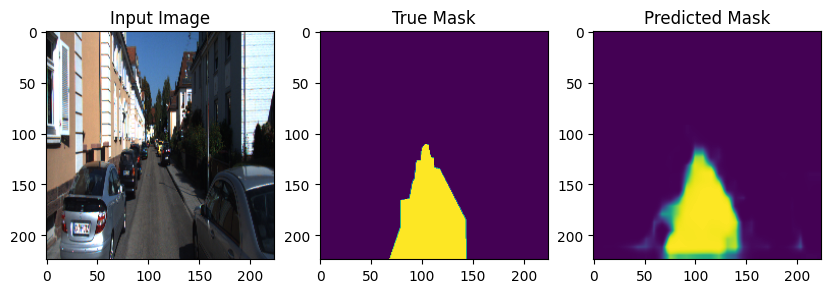


Sample Prediction after epoch 10


Epoch 10: val_loss improved from 0.03808 to 0.03504, saving model to best_model.h5
14/14 [==============================] - 662s 48s/step - loss: 0.0416 - mean_io_u: 0.4141 - val_loss: 0.0350 - val_mean_io_u: 0.4115
Epoch 11/30
1/1 [==============================] - 13s 13s/step


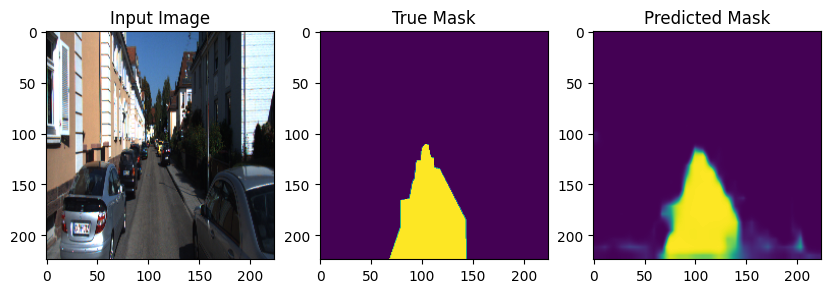


Sample Prediction after epoch 11


Epoch 11: val_loss improved from 0.03504 to 0.03437, saving model to best_model.h5
14/14 [==============================] - 670s 48s/step - loss: 0.0468 - mean_io_u: 0.4119 - val_loss: 0.0344 - val_mean_io_u: 0.4031
Epoch 12/30
1/1 [==============================] - 13s 13s/step


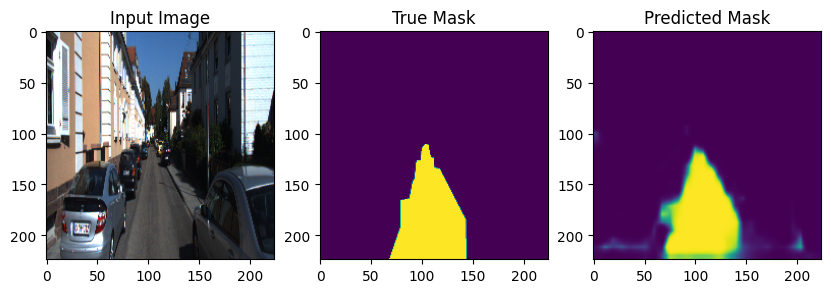


Sample Prediction after epoch 12


Epoch 12: val_loss improved from 0.03437 to 0.03049, saving model to best_model.h5
14/14 [==============================] - 651s 47s/step - loss: 0.0392 - mean_io_u: 0.4139 - val_loss: 0.0305 - val_mean_io_u: 0.4169
Epoch 13/30
1/1 [==============================] - 12s 12s/step


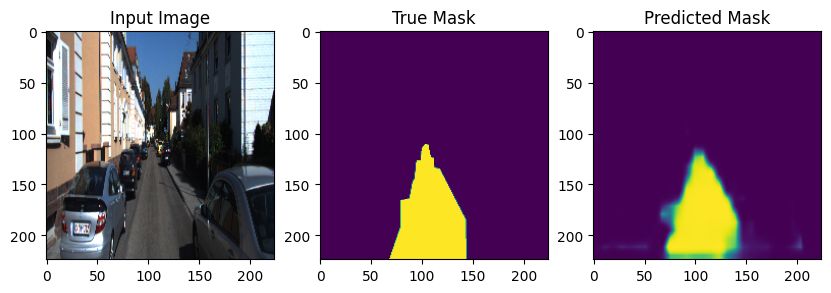


Sample Prediction after epoch 13


Epoch 13: val_loss did not improve from 0.03049
14/14 [==============================] - 659s 47s/step - loss: 0.0350 - mean_io_u: 0.4131 - val_loss: 0.0340 - val_mean_io_u: 0.4136
Epoch 14/30
 3/14 [=====>........................] - ETA: 7:43 - loss: 0.0331 - mean_io_u: 0.4083

In [ ]:
# TRAINING the model.

model_history = model.fit(allDataSets['train'], epochs=EPOCHS, steps_per_epoch=STEPS_PER_EPOCH, validation_data = allDataSets["val"], validation_steps=VALIDATION_STEPS, callbacks = callbacks)



In [ ]:
# Function to calculate mask over image
def weighted_img(img, initial_img, α=1., β=0.5, γ=0.):
    return cv2.addWeighted(initial_img, α, img, β, γ)

# Function to process an individual image and it's mask
def process_image_mask(image, mask):
    # Round to closest
    mask = tf.math.round(mask)

    # Convert to mask image
    zero_image = np.zeros_like(mask)
    mask = np.dstack((mask, zero_image, zero_image))
    mask = np.asarray(mask, np.float32)

    # Convert to image image
    image = np.asarray(image, np.float32)

    # Get the final image
    final_image = weighted_img(mask, image)

    return final_image

# Function to save predictions
def save_predictions(dataset):
    # Predict and save image the from input dataset
    index = 0
    for batch_image, batch_mask in dataset:
        for image, mask in zip(batch_image, batch_mask):
            print(f"Processing image : {index}")
            pred_mask = model.predict(tf.expand_dims(image, axis = 0))
            save_sample([image, process_image_mask(image, pred_mask[0])], index)
            index += 1

# Function to save the images as a plot
def save_sample(display_list, index):
    plt.figure(figsize=(10, 10))

    title = ['Input Image', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')

    plt.savefig(f"outputs/{index}.png")
    plt.show()

Processing image : 0
1/1 [==============================] - 1s 1s/step


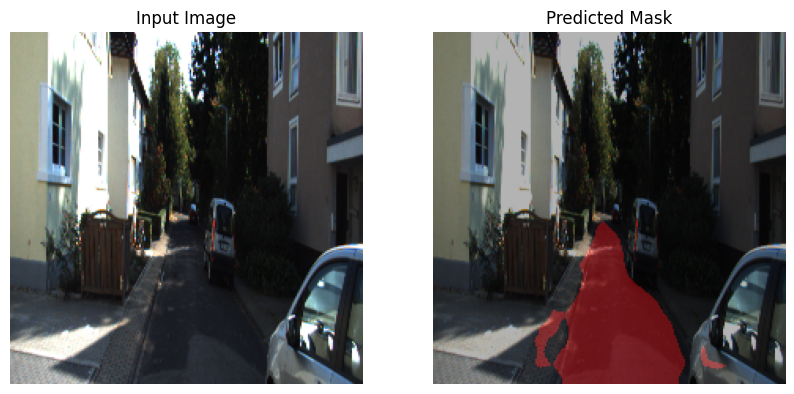

Processing image : 1
1/1 [==============================] - 1s 851ms/step


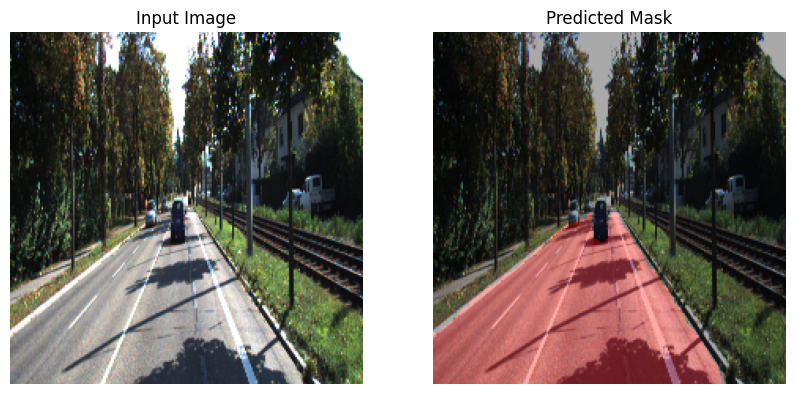

Processing image : 2
1/1 [==============================] - 1s 898ms/step


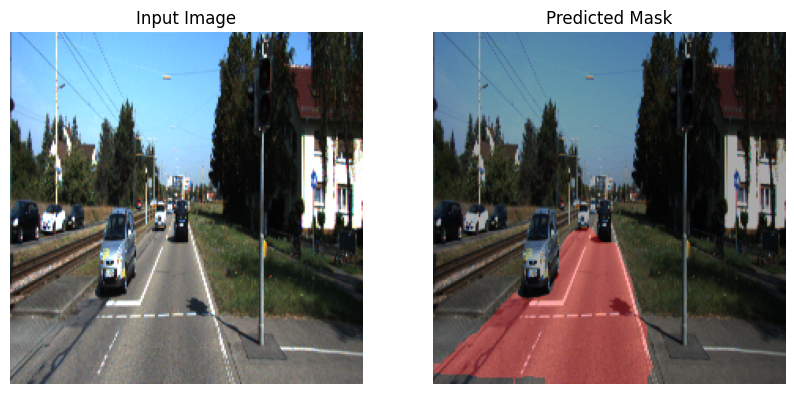

Processing image : 3
1/1 [==============================] - 1s 1s/step


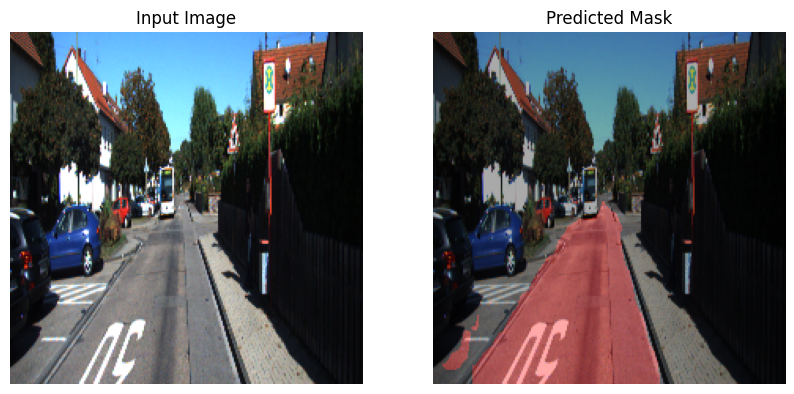

Processing image : 4
1/1 [==============================] - 1s 1s/step


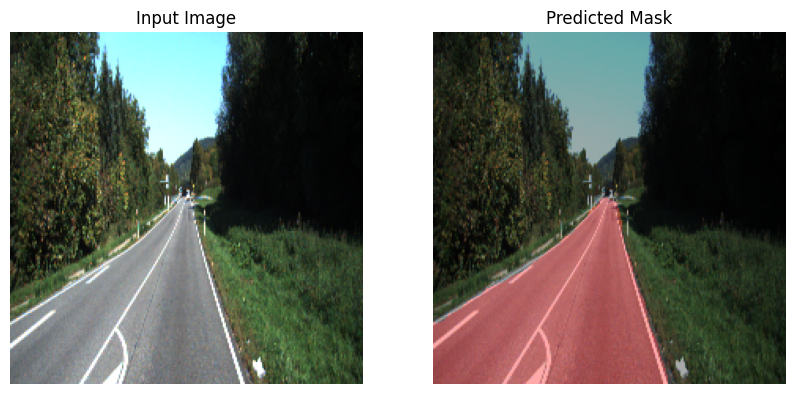

Processing image : 5
1/1 [==============================] - 1s 882ms/step


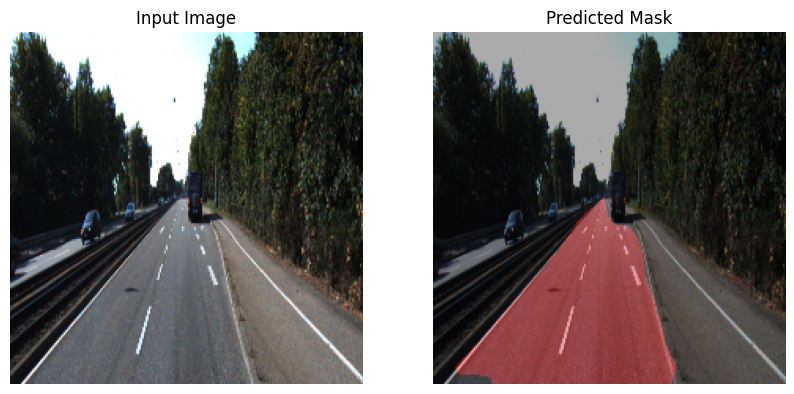

Processing image : 6
1/1 [==============================] - 1s 889ms/step


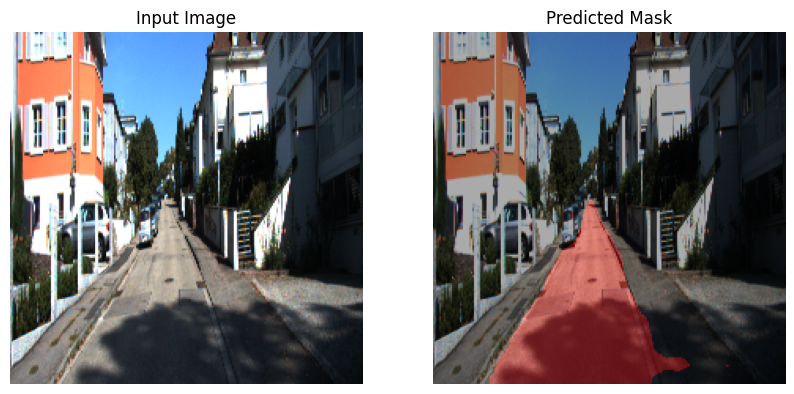

Processing image : 7
1/1 [==============================] - 1s 911ms/step


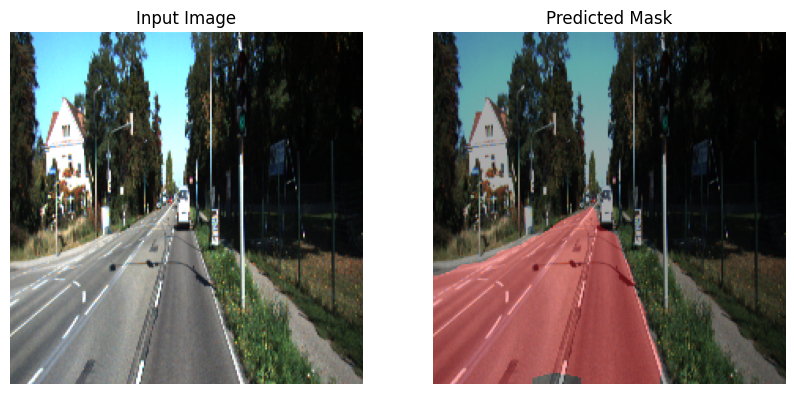

Processing image : 8
1/1 [==============================] - 1s 928ms/step


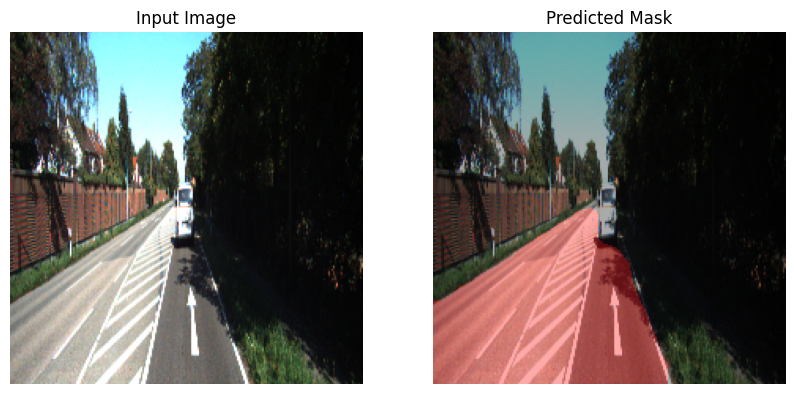

Processing image : 9
1/1 [==============================] - 1s 1s/step


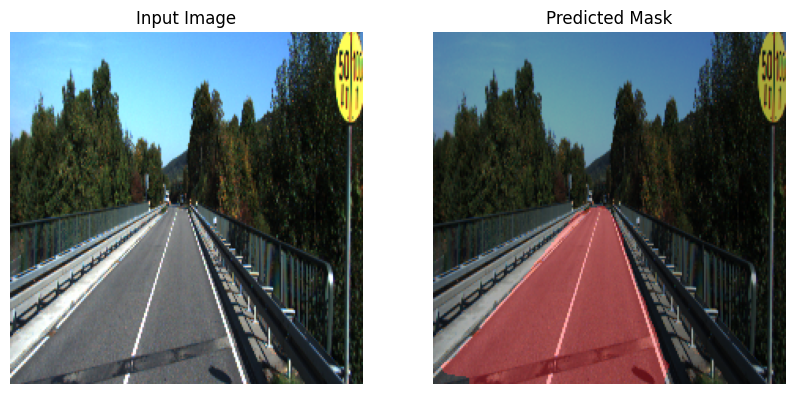

Processing image : 10
1/1 [==============================] - 1s 1s/step


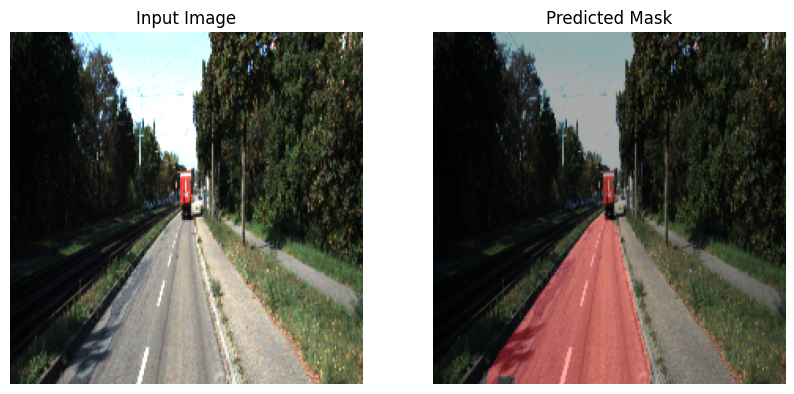

Processing image : 11
1/1 [==============================] - 1s 1s/step


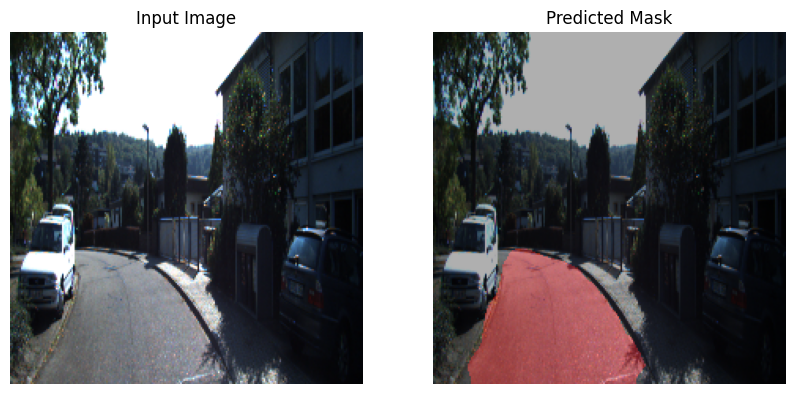

Processing image : 12
1/1 [==============================] - 1s 932ms/step


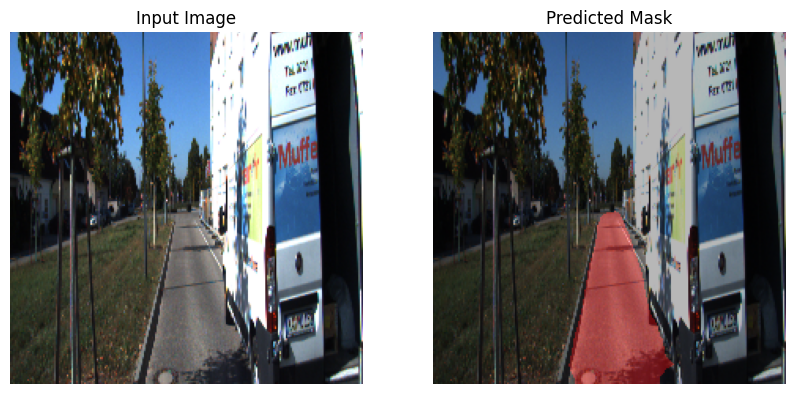

Processing image : 13
1/1 [==============================] - 1s 975ms/step


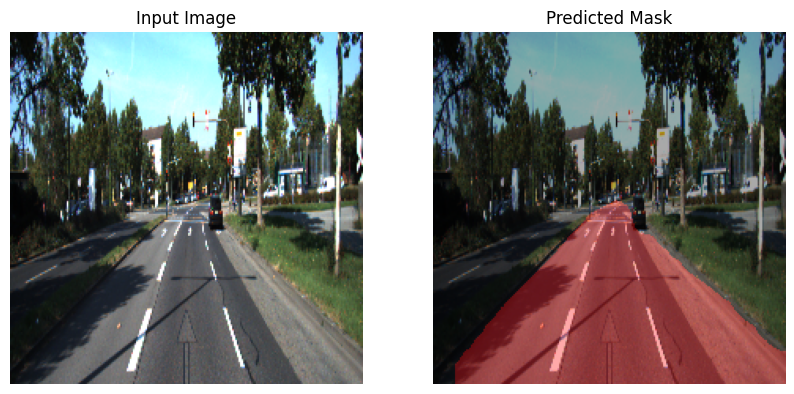

Processing image : 14
1/1 [==============================] - 1s 964ms/step


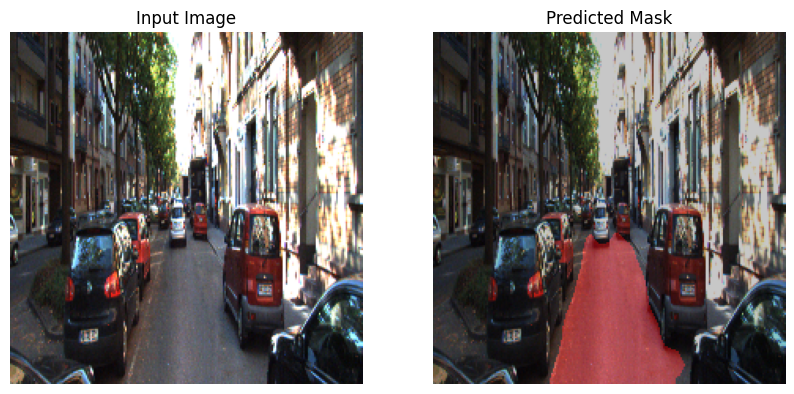

Processing image : 15
1/1 [==============================] - 1s 1s/step


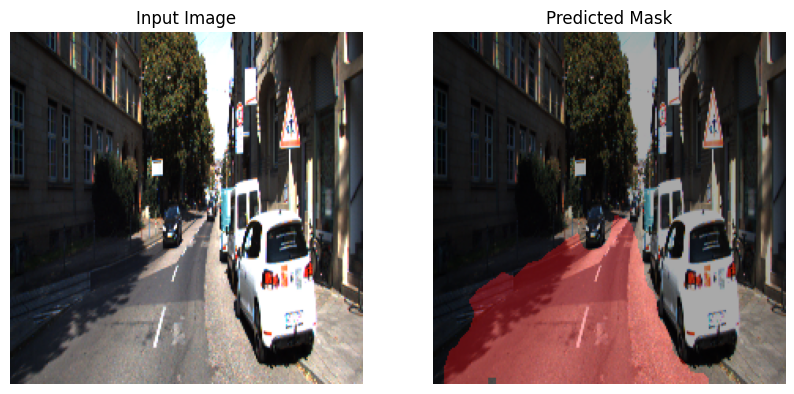

Processing image : 16
1/1 [==============================] - 1s 1s/step


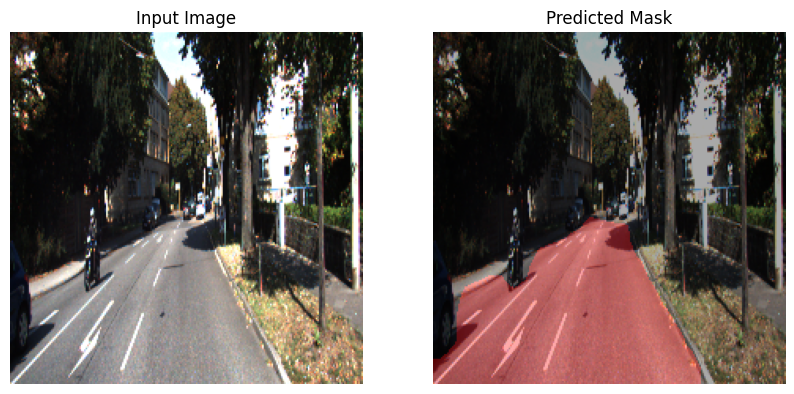

Processing image : 17
1/1 [==============================] - 1s 1s/step


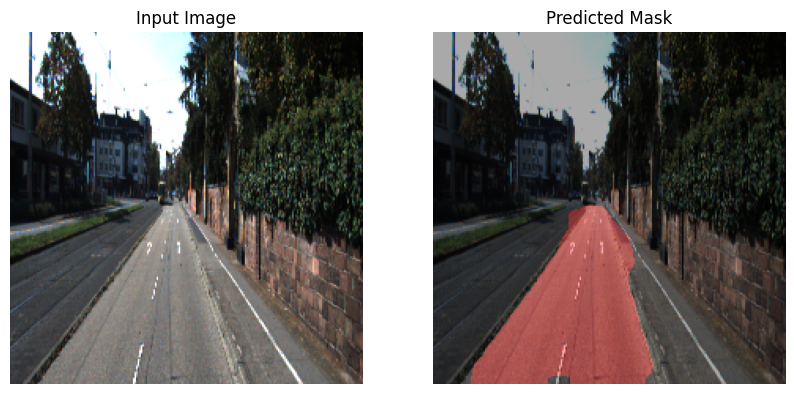

Processing image : 18
1/1 [==============================] - 1s 1s/step


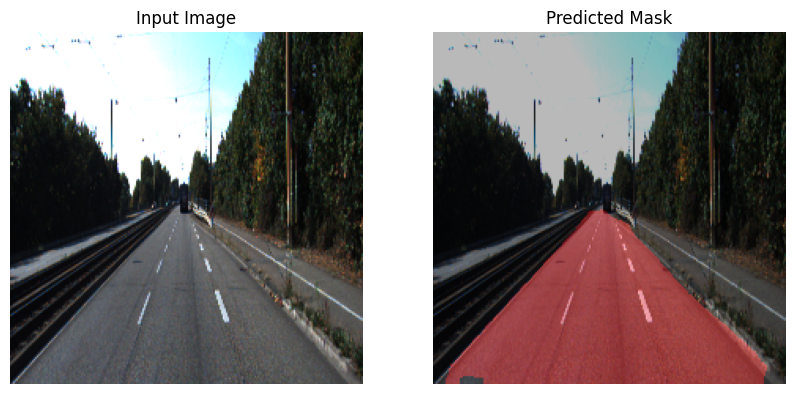

Processing image : 19
1/1 [==============================] - 1s 1s/step


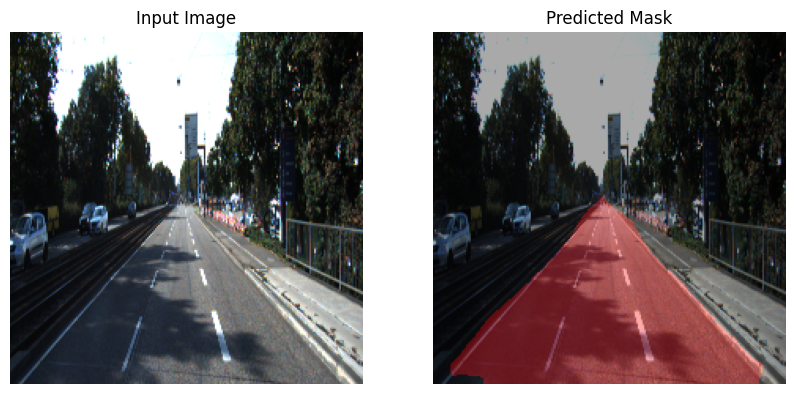

Processing image : 20
1/1 [==============================] - 1s 1s/step


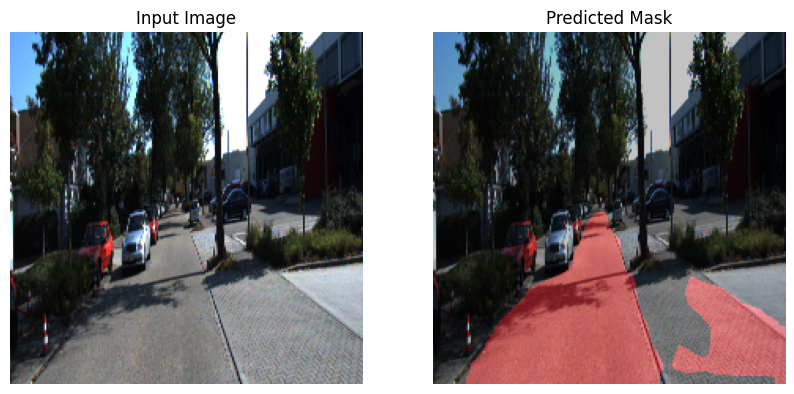

Processing image : 21
1/1 [==============================] - 1s 1s/step


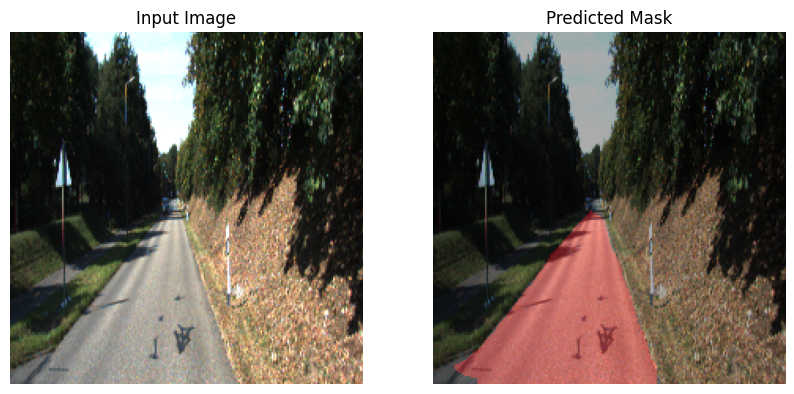

Processing image : 22
1/1 [==============================] - 1s 1s/step


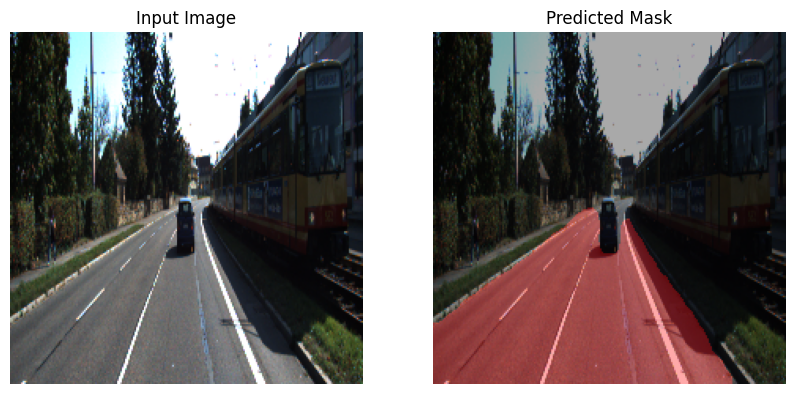

Processing image : 23
1/1 [==============================] - 1s 1s/step


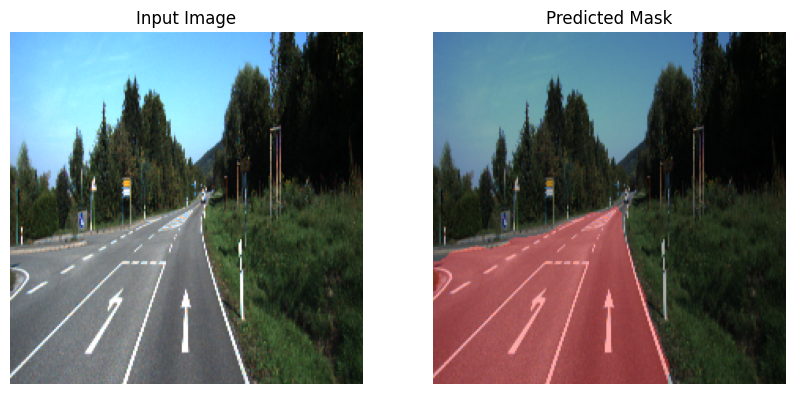

Processing image : 24
1/1 [==============================] - 1s 1s/step


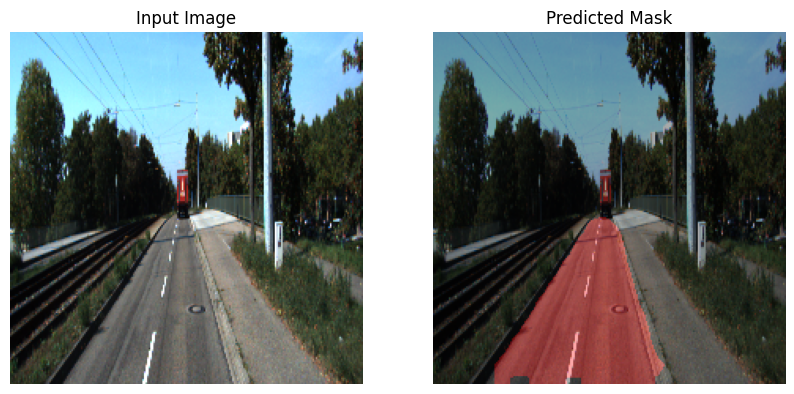

Processing image : 25
1/1 [==============================] - 1s 1s/step


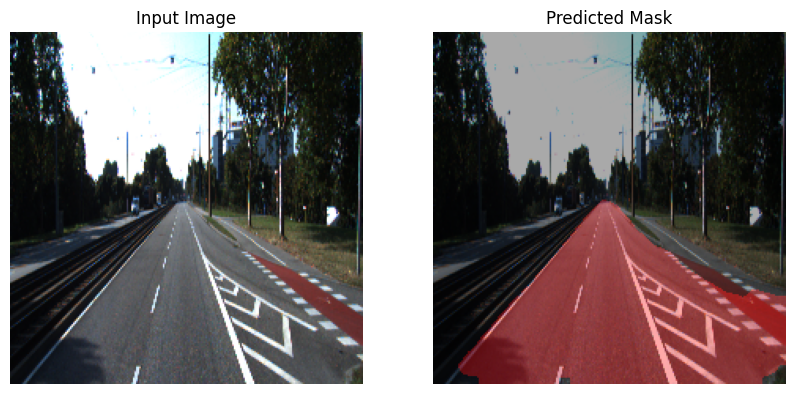

Processing image : 26
1/1 [==============================] - 2s 2s/step


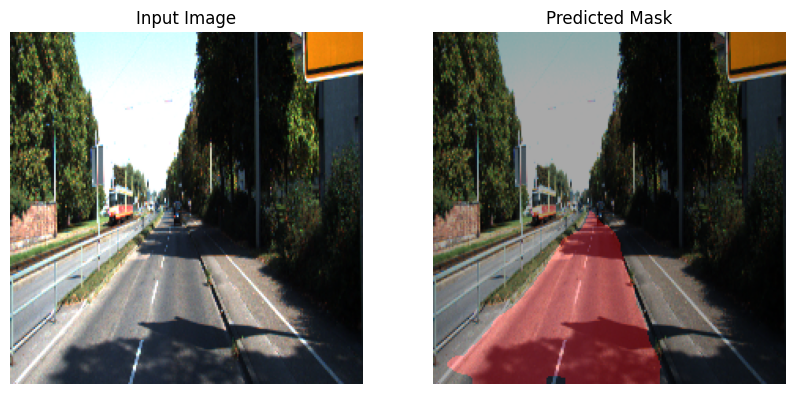

Processing image : 27
1/1 [==============================] - 1s 1s/step


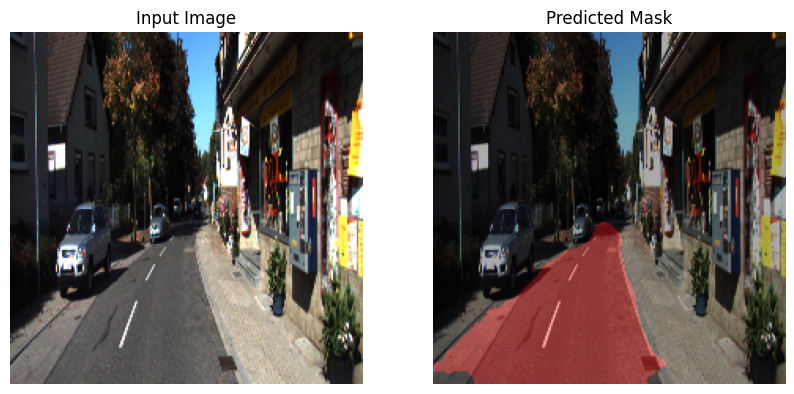

Processing image : 28
1/1 [==============================] - 1s 1s/step


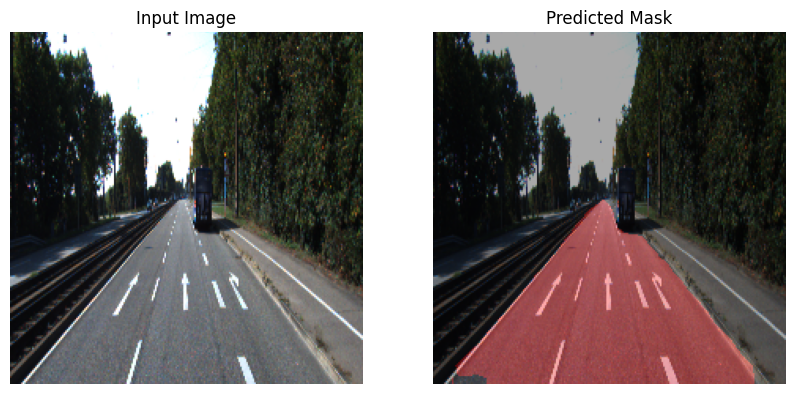

Processing image : 29
1/1 [==============================] - 2s 2s/step


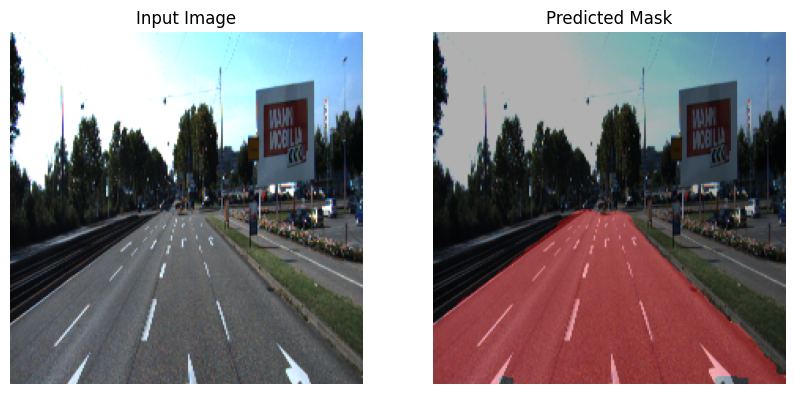

In [ ]:
os.mkdir("outputs")
save_predictions(allDataSets['test'])

In [ ]:
def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)


# Function to process an individual image
def process_image(image):
    # Preprocess image
    image = cv2.resize(image, (imgHeight, imgWidth))
    # Get the binary mask
    pred_mask = model.predict(np.expand_dims(image, axis = 0))
    mask = np.round_(pred_mask[0])

    # Convert to mask image
    zero_image = np.zeros_like(mask)
    mask = np.dstack((mask, zero_image, zero_image)) * 255
    mask = np.asarray(mask, np.uint8)

    # Get the final image
    final_image = weighted_img(mask, image)
    final_image = cv2.resize(final_image, (1280, 720))

    return final_image





In [ ]:
# Make a new directory
if not os.path.exists("videos"):
    os.mkdir("videos")
else:
    print("The 'videos' directory already exists.")

The 'videos' directory already exists.


In [ ]:
# Creating a VideoCapture object to read the video
test_data_dir = "/content/gdrive/My Drive/Colab Notebooks/FCN/data/KITTI-Road-Segmentation/testing/"
project_video = "project_video.mp4"
original_video = cv2.VideoCapture(test_data_dir + project_video)
frame_width = int(original_video.get(3))
frame_height = int(original_video.get(4))

print(frame_width)

# Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
fps = 60
output = cv2.VideoWriter("videos/" + project_video, fourcc, fps, (frame_width,frame_height))

# Process Video
while(original_video.isOpened()):
    ret, frame = original_video.read()

    if ret == True:
        # Write the frame into the file 'output.avi'
        output.write(process_image(frame))

    else:
        break

# When everything done, release the video capture and video write objects
original_video.release()
output.release()

1280
1/1 [==============================] - 1s 831ms/step


In [ ]:
play("videos/" + project_video)

In [ ]:
# To move the image from server to Google Drive folder.
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!scp -r '/content/best_model.h5' '/content/gdrive/My Drive/Colab Notebooks/FCN/best_model_train3/'

In [ ]:


dest_path = '/content/gdrive/My Drive/Colab Notebooks/FCN/best_model_train3/best_model_train3_epoch{}.h5'.format(0+1)
dest_path = repr(dest_path)
!scp -r '/content/videos/' $dest_path


In [ ]:
os.makedirs('/content/gdrive/My Drive/Colab Notebooks/FCN/best_model_train3', exist_ok=True)